# Refine tangram annotations using clustering for brain_s0

In [1]:
slide_id = "brain_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_brain_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 58584, 38957), (3, 29292, 19479)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 11) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (809076, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (809076, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_1305/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 809076 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,41.002191,L5/6 excitatory neuron
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,50.146767,Protoplasmic astrocyte
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,39.986850,Oligodendrocyte
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,23.390865,Endothelial cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,42.130546,Oligodendrocyte progenitor cell
...,...,...,...,...,...
aaamfigp-1,nucleus_boundaries,morpho,aaamfigp-1,6.231723,Microglia
aaamfiha-1,nucleus_boundaries,morpho,aaamfiha-1,6.570084,Oligodendrocyte progenitor cell
aaamfihb-1,nucleus_boundaries,morpho,aaamfihb-1,4.809545,Endothelial cell
aaamfihc-1,nucleus_boundaries,morpho,aaamfihc-1,19.034179,Oligodendrocyte


In [6]:
adata_ini.var

""
A2M
ACE2
ACKR1
ACTA2
ACTB
...
VSIG4
VSIR
VWF
XBP1


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,41.002191,L5/6 excitatory neuron,169
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,50.146767,Protoplasmic astrocyte,161
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,39.986850,Oligodendrocyte,203
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,23.390865,Endothelial cell,41
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,42.130546,Oligodendrocyte progenitor cell,179
...,...,...,...,...,...,...
aaamfigp-1,nucleus_boundaries,morpho,aaamfigp-1,6.231723,Microglia,5
aaamfiha-1,nucleus_boundaries,morpho,aaamfiha-1,6.570084,Oligodendrocyte progenitor cell,14
aaamfihb-1,nucleus_boundaries,morpho,aaamfihb-1,4.809545,Endothelial cell,3
aaamfihc-1,nucleus_boundaries,morpho,aaamfihc-1,19.034179,Oligodendrocyte,15


<Axes: >

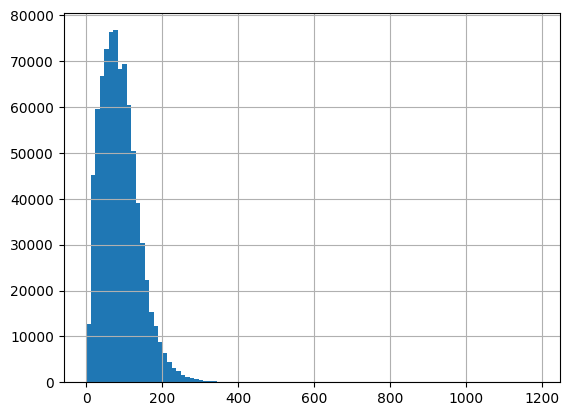

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

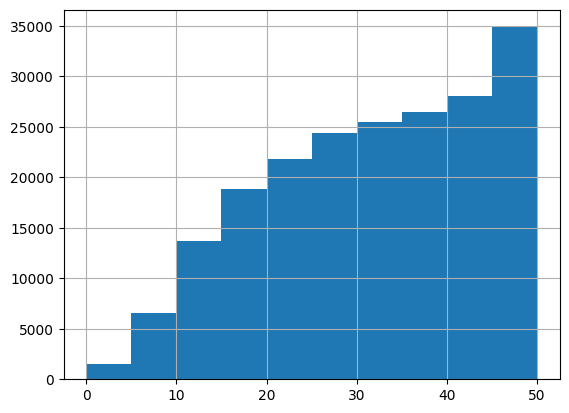

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 40622
Percentage of cells with less than 20 transcripts: 5.02%
-----
Number of cells with less than 15 transcripts: 21784
Percentage of cells with less than 15 transcripts: 2.69%
-----
Number of cells with less than 10 transcripts: 8095
Percentage of cells with less than 10 transcripts: 1.0%
-----
Number total of cells: 809076


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

798751


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


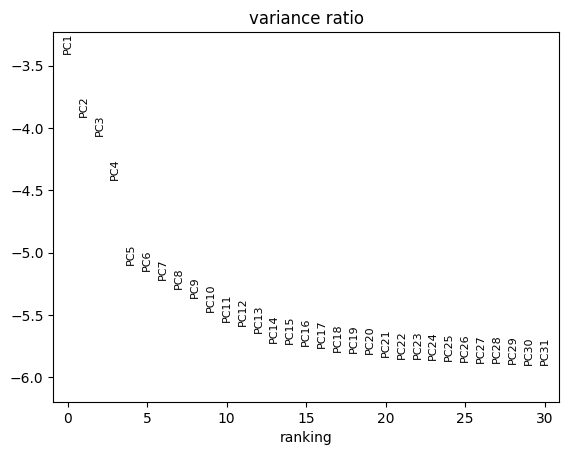

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 798751 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_1305/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


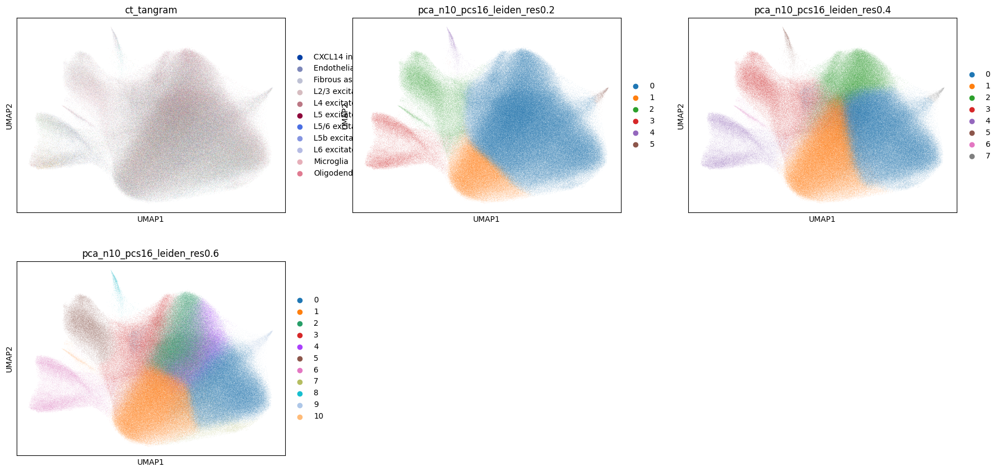

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

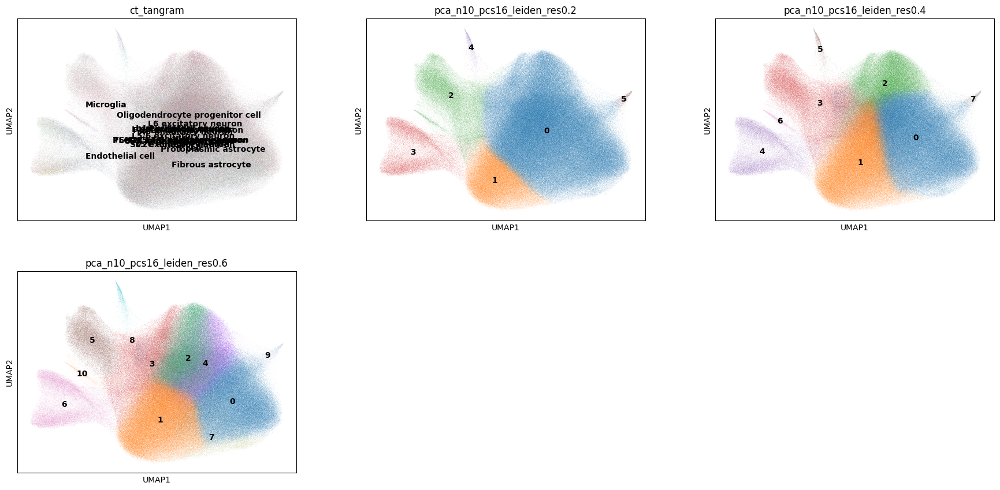

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

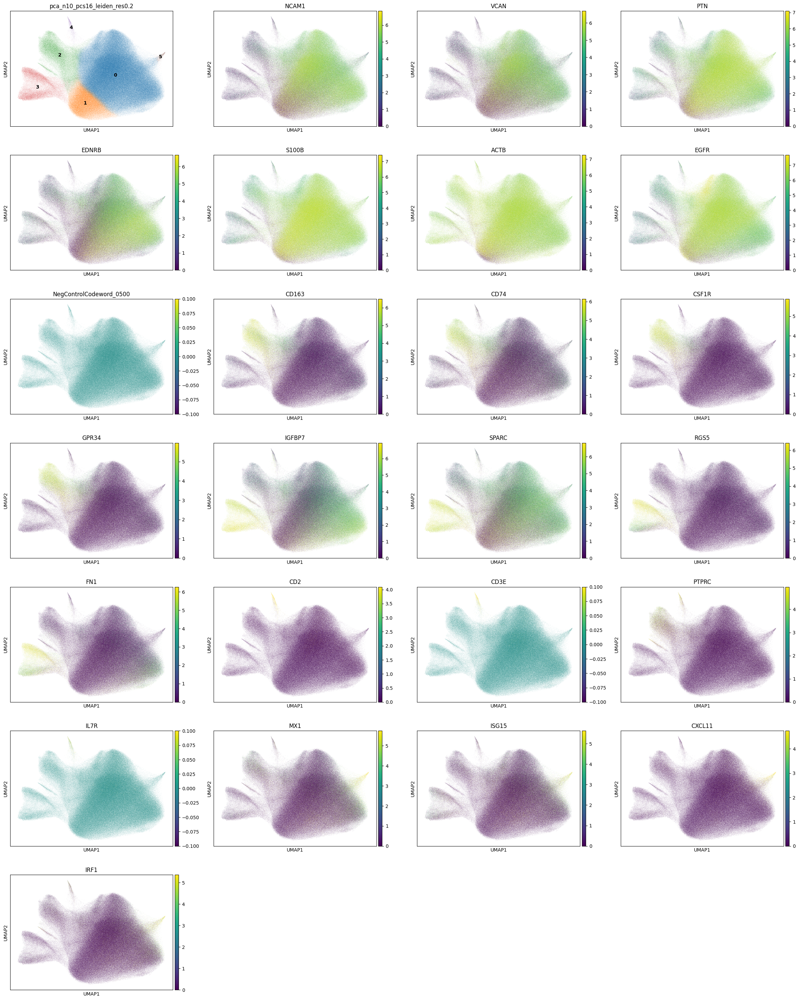

In [22]:
clustering_label = 'pca_n10_pcs16_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

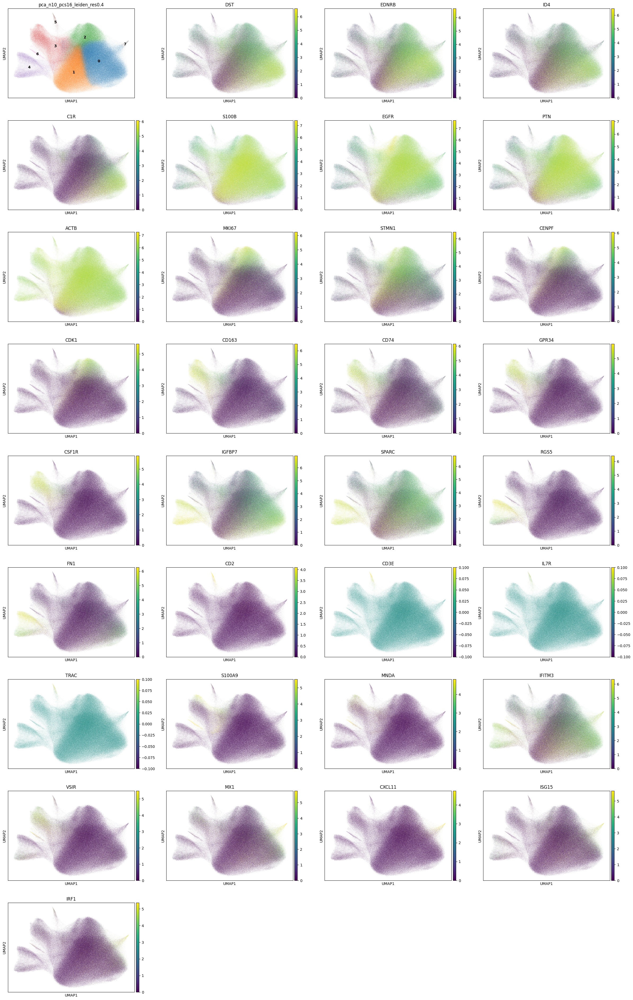

In [23]:
clustering_label = 'pca_n10_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [27]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['2', '0', '4', '3', '5', '1', '6', '7']
Categories (8, object): ['0', '1', '2', '3', '4', '5', '6', '7']

In [28]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'

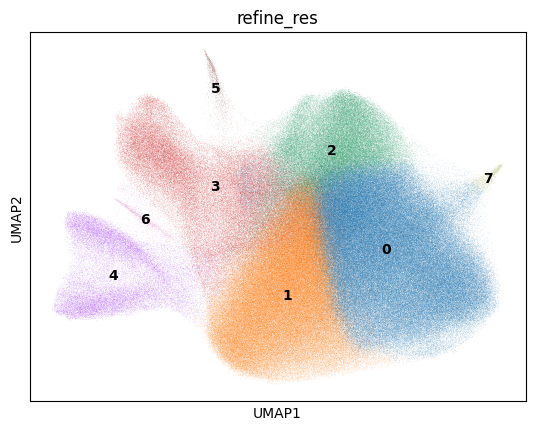

In [29]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [30]:
clustering_label = 'refine_res'

In [31]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_1305/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


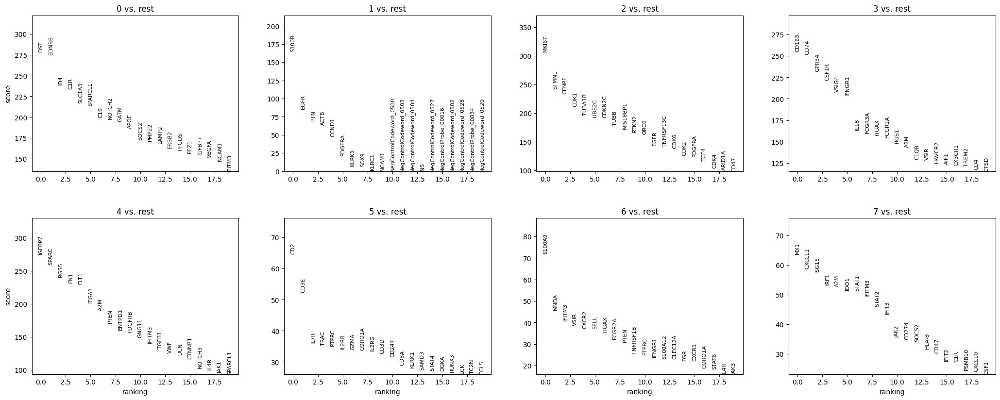

In [32]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [33]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [34]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [50]:
cluster_id = '0'

In [36]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Oligodendrocyte,11
1,0,PVALB inhibitory neuron,8
2,0,Oligodendrocyte progenitor cell,7
3,0,L2/3 excitatory neuron,7
4,0,L6 excitatory neuron,7
5,0,Protoplasmic astrocyte,6
6,0,L4 excitatory neuron,6


In [37]:
top_ranked_genes[cluster_id]

0       DST
1     EDNRB
2       ID4
3       C1R
4    SLC1A3
Name: 0, dtype: object

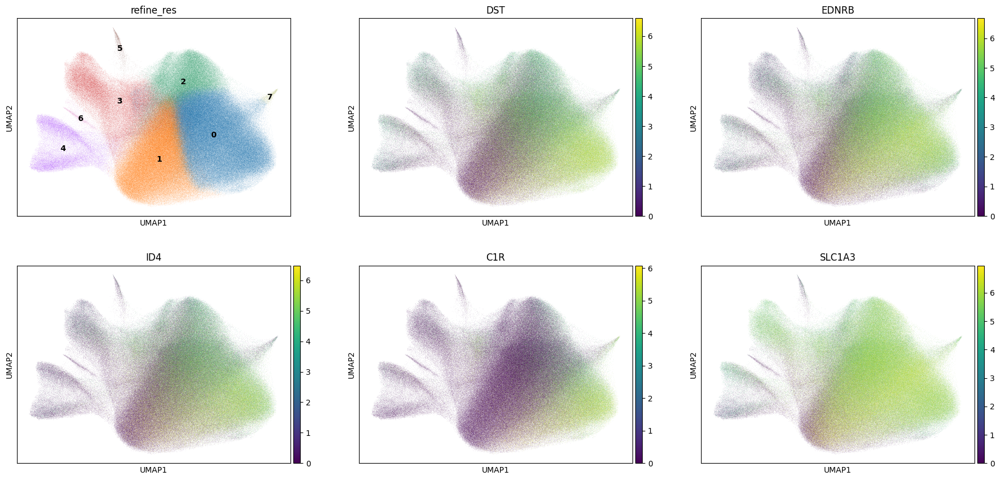

In [38]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [39]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 337965
Percentage of cells in cluster 0: 42.3


In [51]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

### 5.2. Cluster 1

In [52]:
cluster_id = '1'

In [41]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Oligodendrocyte,9
8,1,L2/3 excitatory neuron,8
9,1,Oligodendrocyte progenitor cell,6
10,1,SST inhibitory neuron,6
11,1,TSHZ2 L4/5 excitatory neuron,6
12,1,PVALB inhibitory neuron,6
13,1,L5 excitatory neuron,5


In [42]:
top_ranked_genes[cluster_id]

0    S100B
1     EGFR
2      PTN
3     ACTB
4    CCND1
Name: 1, dtype: object

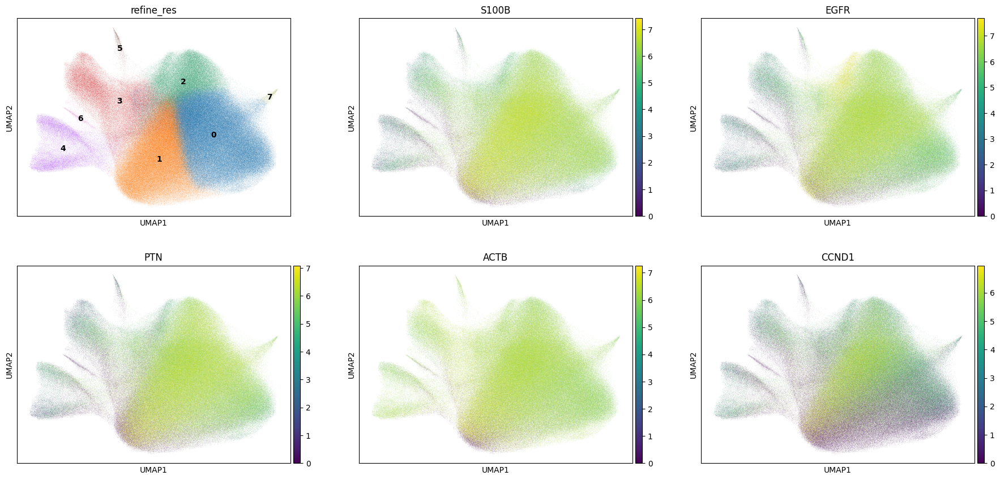

In [43]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [44]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 222580
Percentage of cells in cluster 1: 27.9


In [53]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

### 5.3. Cluster 2

In [54]:
cluster_id = '2'

In [46]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Oligodendrocyte progenitor cell,13
15,2,L2/3 excitatory neuron,11
16,2,Oligodendrocyte,8
17,2,L4 excitatory neuron,8
18,2,PVALB inhibitory neuron,8
19,2,L6 excitatory neuron,8
20,2,Pyramidal neuron,7


In [47]:
top_ranked_genes[cluster_id]

0     MKI67
1     STMN1
2     CENPF
3      CDK1
4    TUBA1B
Name: 2, dtype: object

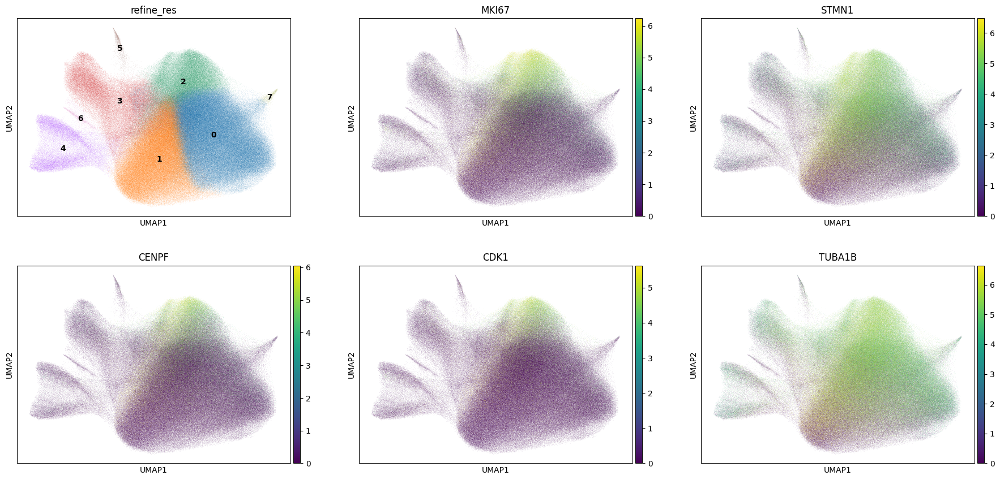

In [48]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [49]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 101127
Percentage of cells in cluster 2: 12.7


In [55]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

### 5.4. Cluster 3

In [90]:
cluster_id = '3'

In [57]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Microglia,29
22,3,L4 excitatory neuron,7
23,3,L6 excitatory neuron,6
24,3,L2/3 excitatory neuron,6
25,3,PVALB inhibitory neuron,6
26,3,Oligodendrocyte,5
27,3,Pyramidal neuron,4


In [58]:
top_ranked_genes[cluster_id]

0    CD163
1     CD74
2    GPR34
3    CSF1R
4    VSIG4
Name: 3, dtype: object

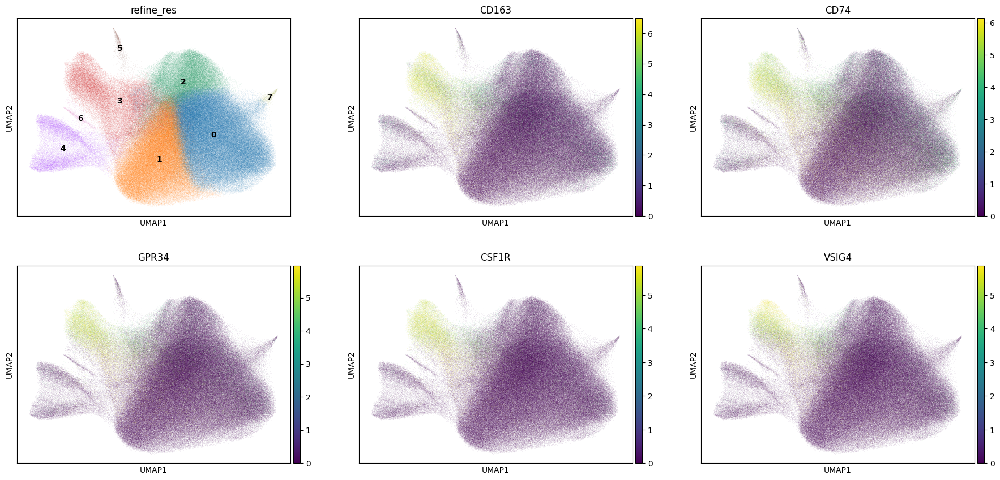

In [59]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [60]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 93420
Percentage of cells in cluster 3: 11.7


In [91]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage'

### 5.5. Cluster 4

In [62]:
cluster_id = '4'

In [63]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Endothelial cell,28
29,4,PVALB inhibitory neuron,13
30,4,SV2C inhibitory neuron,8
31,4,SST inhibitory neuron,7
32,4,L2/3 excitatory neuron,6
33,4,L4 excitatory neuron,5
34,4,L6 excitatory neuron,4


In [64]:
top_ranked_genes[cluster_id]

0    IGFBP7
1     SPARC
2      RGS5
3       FN1
4      FLT1
Name: 4, dtype: object

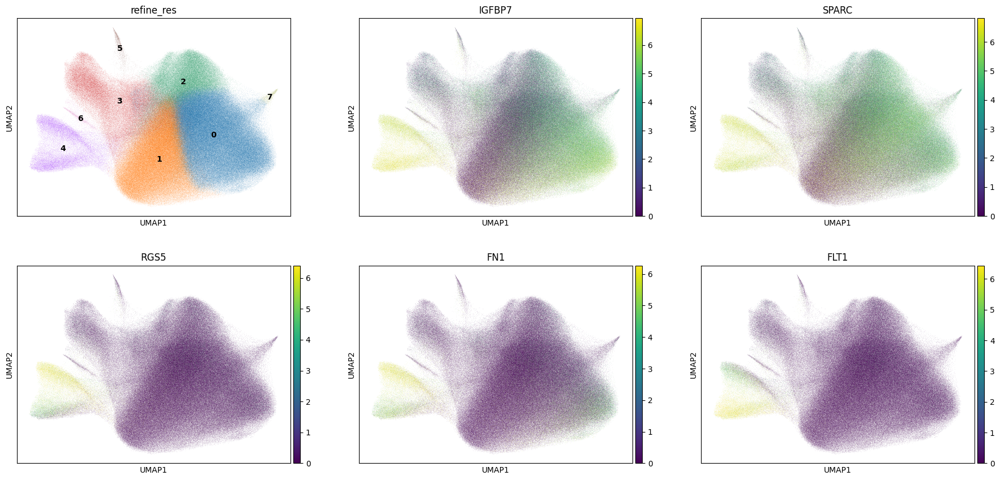

In [65]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [66]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 37546
Percentage of cells in cluster 4: 4.7


In [67]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.6. Cluster 5

In [68]:
cluster_id = '5'

In [69]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,L6 excitatory neuron,26
36,5,L2/3 excitatory neuron,19
37,5,T cell,14
38,5,PVALB inhibitory neuron,5
39,5,SST inhibitory neuron,4
40,5,Endothelial cell,4
41,5,L5b excitatory neuron,4


In [70]:
top_ranked_genes[cluster_id]

0      CD2
1     CD3E
2     IL7R
3     TRAC
4    PTPRC
Name: 5, dtype: object

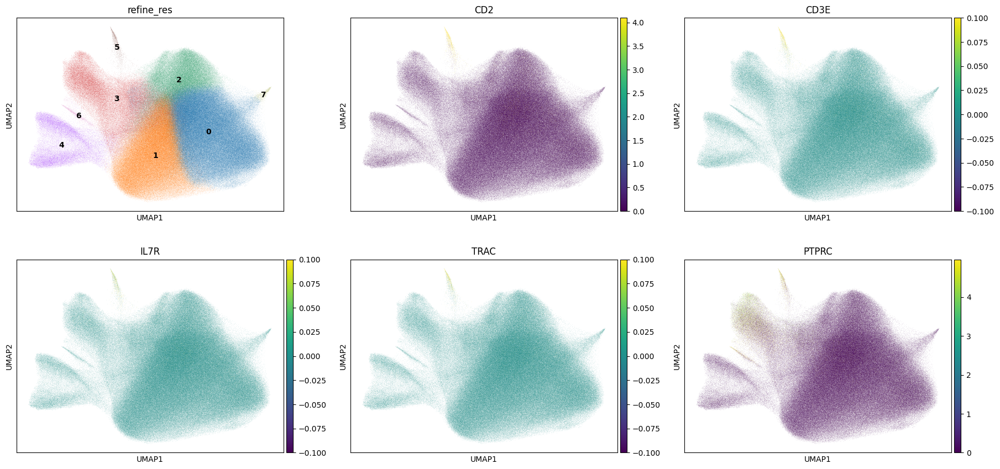

In [71]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [72]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 2483
Percentage of cells in cluster 5: 0.3


In [73]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.7. Cluster 6

In [92]:
cluster_id = '6'

In [75]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,Microglia,44
43,6,Endothelial cell,19
44,6,L4 excitatory neuron,6
45,6,Oligodendrocyte progenitor cell,3
46,6,Protoplasmic astrocyte,2
47,6,SST inhibitory neuron,2
48,6,L6 excitatory neuron,2


In [76]:
top_ranked_genes[cluster_id]

0    S100A9
1      MNDA
2    IFITM3
3      VSIR
4     CXCR2
Name: 6, dtype: object

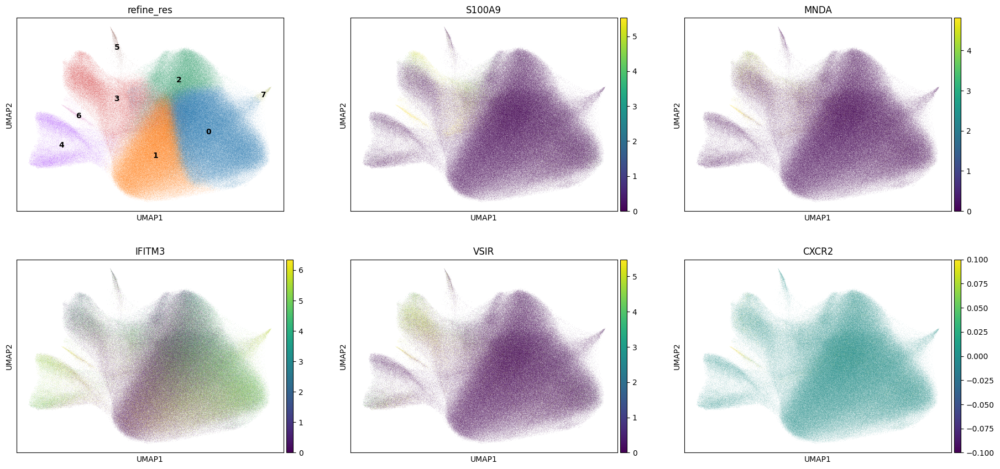

In [82]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [78]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 2096
Percentage of cells in cluster 6: 0.3


In [93]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage'

### 5.8. Cluster 7

In [94]:
cluster_id = '7'

In [84]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,L6 excitatory neuron,18
50,7,L2/3 excitatory neuron,11
51,7,PVALB inhibitory neuron,11
52,7,Endothelial cell,10
53,7,L4 excitatory neuron,6
54,7,Oligodendrocyte progenitor cell,5
55,7,Pyramidal neuron,5


In [85]:
top_ranked_genes[cluster_id]

0       MX1
1    CXCL11
2     ISG15
3      IRF1
4       A2M
Name: 7, dtype: object

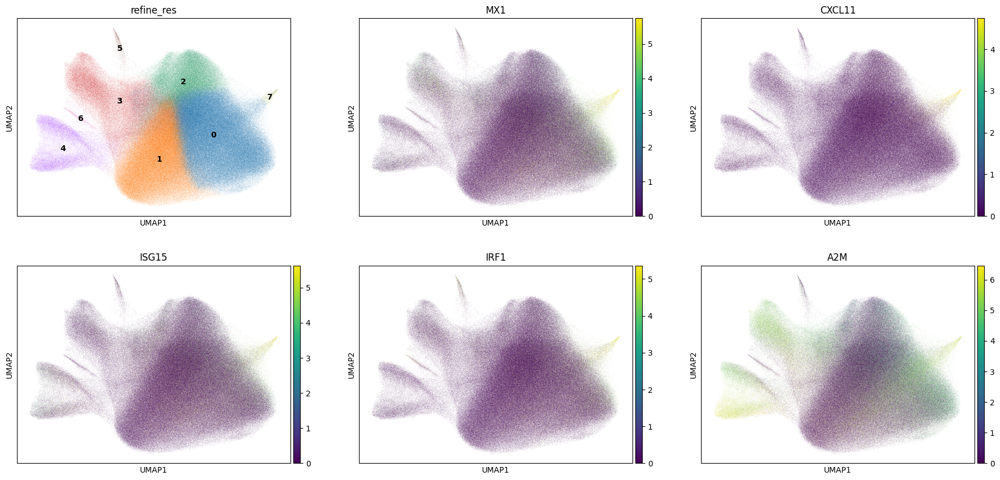

In [86]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [87]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 1534
Percentage of cells in cluster 7: 0.2


In [95]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Glioblastoma_tumor_cell_astrocyte_derived'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Glioblastoma_tumor_cell_astrocyte_derived'

## 6. Cancer cells

In [96]:
adata.obs['label1'].unique()

array(['Glioblastoma_tumor_cell_astrocyte_derived', 'Endothelial',
       'Macrophage', 'T'], dtype=object)

In [97]:
adata.obs['label2'].unique()

array(['Glioblastoma_tumor_cell_astrocyte_derived', 'Endothelial',
       'Macrophage', 'T'], dtype=object)

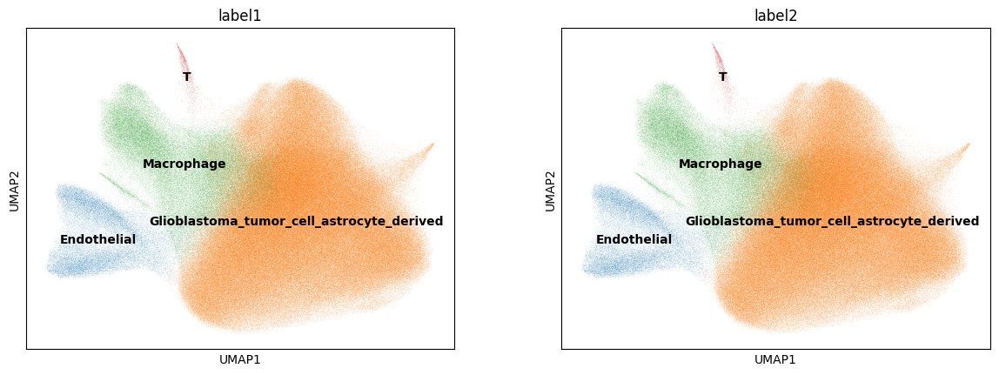

In [98]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [99]:
# Pathway analysis using KEGG pathways # https://www.genome.jp/brite/br08901

s = KEGG()
data = s.get("hsa05214")
dict_data = s.parse(data)
genes_cancer_ref = [info.split(';')[0] for info in dict_data['GENE'].values()]

print(dict_data['NAME'])

['Glioma - Homo sapiens (human)']


In [100]:
genes_cancer = list(set(adata.var_names.tolist()).intersection(genes_cancer_ref))

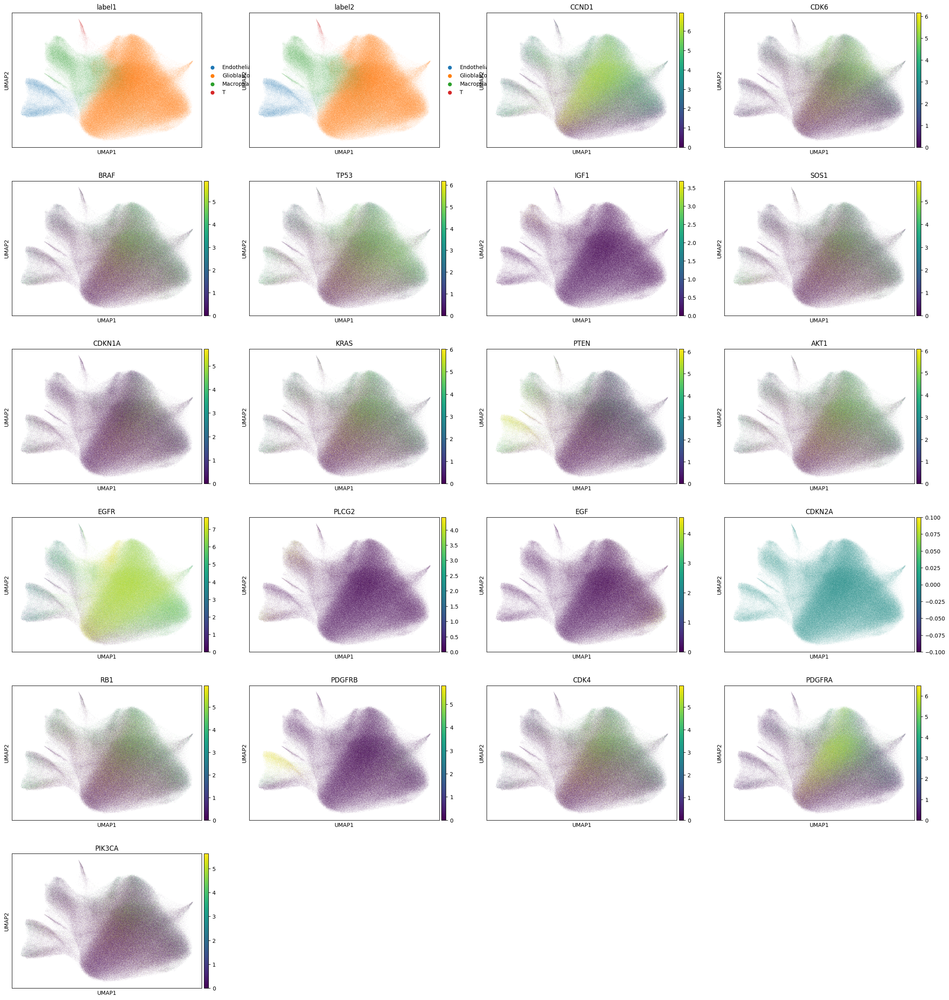

In [101]:
sc.pl.umap(adata, color=['label1', 'label2'] + genes_cancer, vmax="p99", vmin=0, ncols=4)

In [102]:
adata.obs['label1'].unique()

['Glioblastoma_tumor_cell_astrocyte_derived', 'Endothelial', 'Macrophage', 'T']
Categories (4, object): ['Endothelial', 'Glioblastoma_tumor_cell_astrocyte_derived', 'Macrophage', 'T']

In [103]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'
adata.obs.loc[adata.obs['label1'].isin(['Glioblastoma_tumor_cell_astrocyte_derived']), 'label3'] = 'cancer_cell'

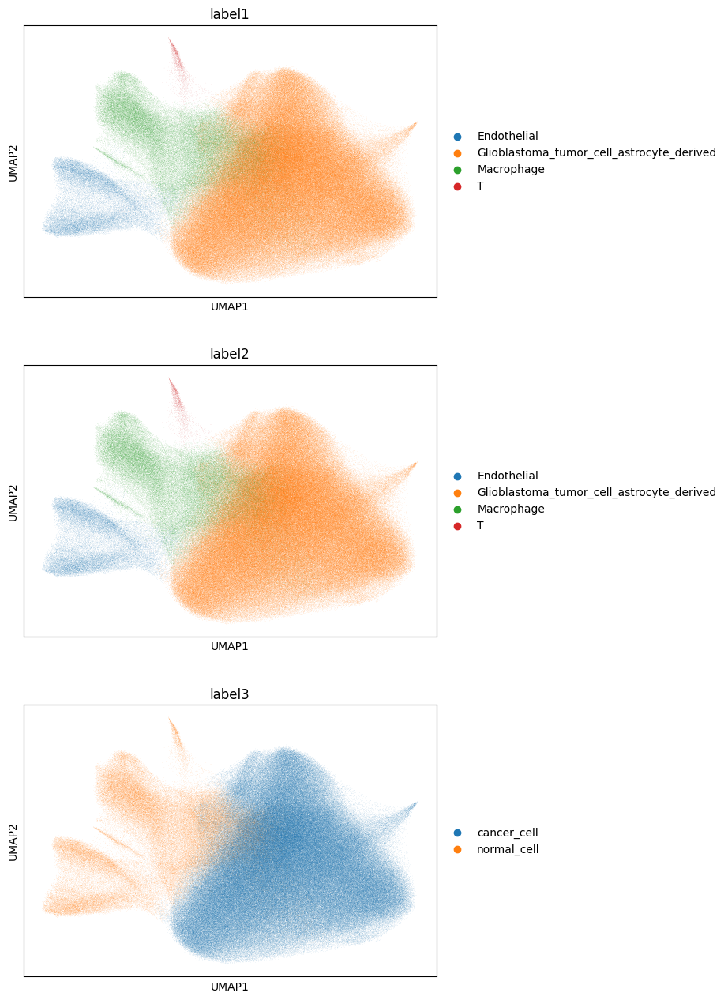

In [104]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [105]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,41.002191,L5/6 excitatory neuron,169,0,2,4,2,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,50.146767,Protoplasmic astrocyte,161,0,0,0,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,39.986850,Oligodendrocyte,203,0,0,0,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,23.390865,Endothelial cell,41,3,4,6,4,Endothelial,Endothelial,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,42.130546,Oligodendrocyte progenitor cell,179,0,0,0,0,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaamfigm-1,nucleus_boundaries,morpho,aaamfigm-1,24.157193,L2/3 excitatory neuron,25,1,1,1,1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell
aaamfign-1,nucleus_boundaries,morpho,aaamfign-1,16.346013,Endothelial cell,22,3,4,6,4,Endothelial,Endothelial,normal_cell
aaamfigo-1,nucleus_boundaries,morpho,aaamfigo-1,15.624592,Endothelial cell,17,2,6,10,6,Macrophage,Macrophage,normal_cell
aaamfiha-1,nucleus_boundaries,morpho,aaamfiha-1,6.570084,Oligodendrocyte progenitor cell,14,1,1,1,1,Glioblastoma_tumor_cell_astrocyte_derived,Glioblastoma_tumor_cell_astrocyte_derived,cancer_cell


In [106]:
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")